<a href="https://colab.research.google.com/github/alfitranurr/MACHINE-LEARNING/blob/main/UAP/UAP_Machine_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Non-Pretrained (CNN)

In [ ]:
import os
import zipfile
import shutil
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from collections import Counter

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

from google.colab import drive

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

print("Semua library berhasil diimpor!")

Semua library berhasil diimpor!


In [ ]:
drive.mount('/content/drive')

# Path dataset asli (bukan zip, langsung folder)
dataset_path = '/content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/'

# Kelas dataset
classes = ['tulip', 'sunflower', 'rose', 'dandelion', 'daisy']

# Cek isi folder dataset
print("Isi folder dataset:")
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    if os.path.exists(class_path):
        num_files = len([f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
        print(f"Kelas {cls}: {num_files} gambar")
    else:
        print(f"Warning: Folder {cls} tidak ditemukan di {dataset_path}. Periksa struktur folder!")

base_dir = dataset_path
print(f"\nDataset sumber: {base_dir}")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Isi folder dataset:
Kelas tulip: 607 gambar
Kelas sunflower: 495 gambar
Kelas rose: 497 gambar
Kelas dandelion: 646 gambar
Kelas daisy: 238 gambar

Dataset sumber: /content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/


In [ ]:
# Buat struktur folder untuk train, val, test
dataset_dir = '/content/structured_dataset'
train_dir = os.path.join(dataset_dir, 'train')
val_dir = os.path.join(dataset_dir, 'val')
test_dir = os.path.join(dataset_dir, 'test')

for split in ['train', 'val', 'test']:
    split_path = os.path.join(dataset_dir, split)
    os.makedirs(split_path, exist_ok=True)
    for cls in classes:
        os.makedirs(os.path.join(split_path, cls), exist_ok=True)

print("Struktur folder train, val, dan test berhasil dibuat!")
print(f"Dataset sumber: {base_dir}")

Struktur folder train, val, dan test berhasil dibuat!
Dataset sumber: /content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/


In [ ]:
train_ratio = 0.70
val_ratio = 0.15
test_ratio = 0.15

def split_dataset(base_dir, train_dir, val_dir, test_dir, classes, train_ratio, val_ratio, test_ratio):
    for cls in classes:
        class_path = os.path.join(base_dir, cls)
        if not os.path.exists(class_path):
            print(f"Error: Folder {cls} tidak ditemukan di {base_dir}. Periksa langkah 2.")
            continue
        files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

        random.shuffle(files)

        total = len(files)
        train_size = int(total * train_ratio)
        val_size = int(total * val_ratio)

        train_files = files[:train_size]
        val_files = files[train_size:train_size + val_size]
        test_files = files[train_size + val_size:]

        # Copy files ke folder split
        for file in train_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(train_dir, cls, file))

        for file in val_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(val_dir, cls, file))

        for file in test_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(test_dir, cls, file))

        print(f"Kelas {cls}: Train={len(train_files)}, Val={len(val_files)}, Test={len(test_files)}")

split_dataset(base_dir, train_dir, val_dir, test_dir, classes, train_ratio, val_ratio, test_ratio)

print("Dataset berhasil dibagi!")

Kelas tulip: Train=424, Val=91, Test=92
Kelas sunflower: Train=346, Val=74, Test=75
Kelas rose: Train=347, Val=74, Test=76
Kelas dandelion: Train=452, Val=96, Test=98
Kelas daisy: Train=350, Val=75, Test=76
Dataset berhasil dibagi!


Total dataset asli: 2746
Train: 1919 (69.9%)
Val: 410 (14.9%)
Test: 417 (15.2%)


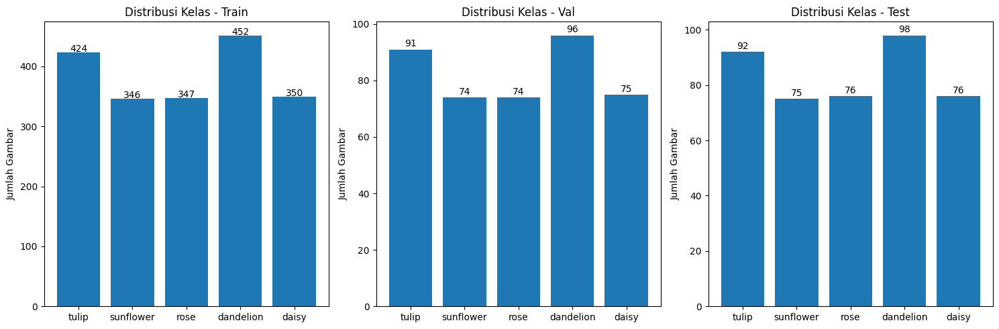


Ukuran gambar sample (10 per kelas dari train asli):
                                                                                                                             Ukuran
Kelas                                                                                                                              
daisy      [(320, 240), (500, 332), (320, 213), (240, 216), (320, 240), (320, 213), (320, 199), (320, 213), (320, 213), (320, 221)]
dandelion  [(320, 240), (500, 313), (320, 273), (500, 333), (500, 333), (225, 240), (500, 331), (189, 240), (500, 333), (500, 333)]
rose       [(320, 240), (500, 333), (211, 240), (178, 240), (320, 228), (500, 333), (500, 333), (320, 240), (320, 240), (500, 313)]
sunflower  [(180, 240), (320, 239), (500, 333), (320, 240), (500, 281), (500, 334), (320, 240), (320, 240), (500, 333), (500, 331)]
tulip      [(500, 333), (320, 211), (320, 240), (320, 213), (500, 241), (320, 240), (320, 212), (500, 334), (500, 333), (320, 240)]


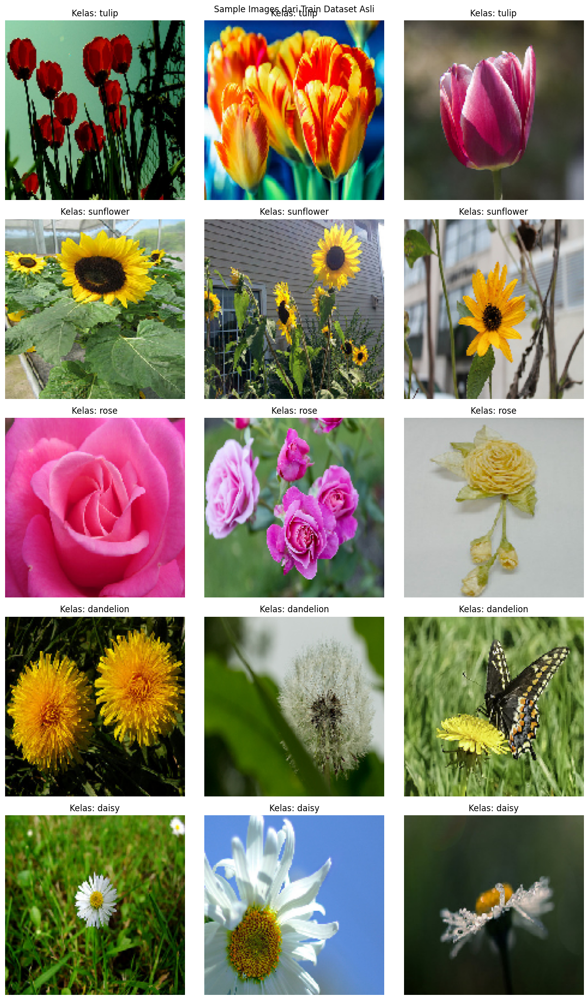

In [ ]:
def count_files(directory):
    counts = {}
    for split in ['train', 'val', 'test']:
        split_path = os.path.join(directory, split)
        counts[split] = {}
        for cls in classes:
            class_path = os.path.join(split_path, cls)
            counts[split][cls] = len([f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
    return counts

counts = count_files(dataset_dir)

total_train = sum(counts['train'].values())
total_val = sum(counts['val'].values())
total_test = sum(counts['test'].values())
total_dataset = total_train + total_val + total_test

print(f"Total dataset asli: {total_dataset}")
print(f"Train: {total_train} ({total_train/total_dataset*100:.1f}%)")
print(f"Val: {total_val} ({total_val/total_dataset*100:.1f}%)")
print(f"Test: {total_test} ({total_test/total_dataset*100:.1f}%)")

# Plot distribusi kelas
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, split in enumerate(['train', 'val', 'test']):
    cls_counts = list(counts[split].values())
    axes[i].bar(classes, cls_counts)
    axes[i].set_title(f'Distribusi Kelas - {split.capitalize()}')
    axes[i].set_ylabel('Jumlah Gambar')
    for j, v in enumerate(cls_counts):
        axes[i].text(j, v + 1, str(v), ha='center')

plt.tight_layout()
plt.show()

# Analisis ukuran gambar sample
def get_image_sizes(base_dir, classes, num_samples=10):
    sizes = []
    for cls in classes:
        class_path = os.path.join(base_dir, cls)
        files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:num_samples]
        for file in files:
            try:
                img = Image.open(os.path.join(class_path, file))
                sizes.append((cls, img.size, img.mode))
            except Exception as e:
                print(f"Error membaca {file}: {e}")
    return sizes

train_base = os.path.join(dataset_dir, 'train')
sizes = get_image_sizes(train_base, classes)
df_sizes = pd.DataFrame(sizes, columns=['Kelas', 'Ukuran', 'Mode'])
print("\nUkuran gambar sample (10 per kelas dari train asli):")
print(df_sizes.groupby('Kelas').agg({'Ukuran': list}).to_string())

# Sample images
fig, axes = plt.subplots(5, 3, figsize=(12, 20))  # 5 kelas x 3 sample
axes = axes.ravel()
sample_files = []
for cls in classes:
    class_path = os.path.join(train_base, cls)
    files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:3]
    sample_files.extend([(os.path.join(class_path, f), cls) for f in files])

for i, (file_path, cls) in enumerate(sample_files):
    try:
        img = load_img(file_path, target_size=(150, 150))
        axes[i].imshow(img)
        axes[i].set_title(f'Kelas: {cls}')
        axes[i].axis('off')
    except Exception as e:
        axes[i].text(0.5, 0.5, f'Error: {e}', ha='center', va='center')
        axes[i].set_title(f'Kelas: {cls}')

plt.suptitle('Sample Images dari Train Dataset Asli')
plt.tight_layout()
plt.show()

In [ ]:
# Augmentasi train set hingga ~1100 per kelas (generate dan simpan augmented images)
IMG_SIZE = (224, 224)
BATCH_SIZE = 32
TARGET_PER_CLASS = 1100  # Target augmentasi per kelas di train

# Hapus isi train folder lama untuk diganti dengan augmented
for cls in classes:
    cls_path = os.path.join(train_dir, cls)
    for file in os.listdir(cls_path):
        os.remove(os.path.join(cls_path, file))

print("Memulai augmentasi train set...")

augment_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.3,
    height_shift_range=0.3,
    horizontal_flip=True,
    vertical_flip=True,
    shear_range=0.3,
    zoom_range=0.3,
    brightness_range=[0.7, 1.3],
    channel_shift_range=20.0,
    fill_mode='nearest'
)

for cls in classes:
    cls_path = os.path.join(train_dir, cls)
    # Load original train files untuk augmentasi
    original_files = [f for f in os.listdir(os.path.join(dataset_dir, 'train_original' if os.path.exists(os.path.join(dataset_dir, 'train_original', cls)) else cls_path))
                      if f.lower().endswith(('.png', '.jpg', '.jpeg'))]  # Asumsi original di train_dir awal, tapi kita gunakan copy sementara
    # Untuk simplicity, kita augment dari original train files yang sudah di-copy sebelumnya, tapi generate new
    current_count = len([f for f in os.listdir(cls_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
    needed = max(0, TARGET_PER_CLASS - current_count)

    if needed > 0:
        # Buat temp generator dari original class folder untuk augment
        temp_gen = augment_datagen.flow_from_directory(
            base_dir,  # Dari base untuk akses original
            classes=[cls],
            target_size=IMG_SIZE,
            batch_size=1,
            shuffle=True,
            save_to_dir=cls_path,
            save_prefix='aug',
            save_format='jpeg'
        )
        # Generate needed images
        num_batches = needed // 1 + 1
        for _ in range(num_batches):
            batch = next(temp_gen)
            if len(os.listdir(cls_path)) >= TARGET_PER_CLASS:
                break
        # Hapus temp files jika ada
        temp_files = [f for f in os.listdir(cls_path) if f.startswith('aug_')]
        # Keep only up to target
        all_files = [f for f in os.listdir(cls_path) if f.lower().endswith('.jpeg')]
        if len(all_files) > TARGET_PER_CLASS:
            excess = all_files[TARGET_PER_CLASS:]
            for ex in excess:
                os.remove(os.path.join(cls_path, ex))

    final_count = len([f for f in os.listdir(cls_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
    print(f"Kelas {cls}: Augmented train = {final_count} gambar")

print("Augmentasi train set selesai! Setiap kelas ~1100 gambar.")

Memulai augmentasi train set...
Found 607 images belonging to 1 classes.
Kelas tulip: Augmented train = 1100 gambar
Found 495 images belonging to 1 classes.
Kelas sunflower: Augmented train = 1100 gambar
Found 497 images belonging to 1 classes.
Kelas rose: Augmented train = 1100 gambar
Found 646 images belonging to 1 classes.
Kelas dandelion: Augmented train = 1100 gambar
Found 501 images belonging to 1 classes.
Kelas daisy: Augmented train = 1100 gambar
Augmentasi train set selesai! Setiap kelas ~1100 gambar.


In [ ]:
# Data generators (augmentasi on-the-fly untuk training, rescale saja untuk val/test)
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    shear_range=0.2,
    zoom_range=0.2,
    fill_mode='nearest'
)

val_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=True
)

val_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=False
)

print("Generator berhasil dibuat dengan pre-processing dan augmentation on-the-fly!")
print(f"Train samples: {train_generator.samples}")
print(f"Val samples: {val_generator.samples}")
print(f"Test samples: {test_generator.samples}")

Found 5500 images belonging to 5 classes.
Found 410 images belonging to 5 classes.
Found 417 images belonging to 5 classes.
Generator berhasil dibuat dengan pre-processing dan augmentation on-the-fly!
Train samples: 5500
Val samples: 410
Test samples: 417


In [ ]:
# Bangun CNN non-pretrained dari awal
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(*IMG_SIZE, 3)),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(64, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Conv2D(128, (3, 3), activation='relu'),
    BatchNormalization(),
    MaxPooling2D(2, 2),

    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(256, activation='relu'),
    Dropout(0.3),
    Dense(len(classes), activation='softmax')
])

model.compile(
    optimizer=Adam(learning_rate=0.001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

print("Model CNN non-pretrained berhasil dibangun!")

/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)               │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 222, 222, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 109, 109, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 52, 52, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 24, 24, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 24, 24, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_6 (MaxPooling2D)  │ (None, 12, 12, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 18432)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 512)            │     9,437,696 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 5)              │         1,285 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 9,812,549 (37.43 MB)

 Trainable params: 9,811,845 (37.43 MB)

 Non-trainable params: 704 (2.75 KB)

Model CNN non-pretrained berhasil dibangun!


In [ ]:
# Callbacks untuk training optimal
callbacks = [
    EarlyStopping(monitor='val_loss', patience=7, restore_best_weights=True),
    ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=4, min_lr=1e-7, verbose=1)
]

EPOCHS = 20

history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // BATCH_SIZE,
    epochs=EPOCHS,
    validation_data=val_generator,
    validation_steps=val_generator.samples // BATCH_SIZE,
    callbacks=callbacks,
    verbose=1
)

# Simpan model
model_save_dir = '/content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/MODEL/'
os.makedirs(model_save_dir, exist_ok=True)
model.save(os.path.join(model_save_dir, 'non-pretrained.h5'))
print("Pelatihan selesai! Model 'non-pretrained.h5' disimpan ke Drive.")

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 93s 476ms/step - accuracy: 0.3268 - loss: 5.2075 - val_accuracy: 0.2708 - val_loss: 1.7548 - learning_rate: 0.0010
Epoch 2/20
  1/171 ━━━━━━━━━━━━━━━━━━━━ 10s 61ms/step - accuracy: 0.4688 - loss: 1.6529

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.4688 - loss: 1.6529 - val_accuracy: 0.2786 - val_loss: 1.7360 - learning_rate: 0.0010
Epoch 3/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 71s 417ms/step - accuracy: 0.3605 - loss: 1.7777 - val_accuracy: 0.3203 - val_loss: 1.4851 - learning_rate: 0.0010
Epoch 4/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.3438 - loss: 1.4750 - val_accuracy: 0.3281 - val_loss: 1.4876 - learning_rate: 0.0010
Epoch 5/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 74s 431ms/step - accuracy: 0.4503 - loss: 1.3520 - val_accuracy: 0.5547 - val_loss: 1.2004 - learning_rate: 0.0010
Epoch 6/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.3125 - loss: 1.8134 - val_accuracy: 0.5547 - val_loss: 1.2033 - learning_rate: 0.0010
Epoch 7/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 71s 415ms/step - accuracy: 0.4743 - loss: 1.2724 - val_accuracy: 0.5885 - val_loss: 1.1740 - learning_rate: 0.0010
Epoch 8/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5625 - loss: 1.2388 - va

Pelatihan selesai! Model 'non-pretrained.h5' disimpan ke Drive.


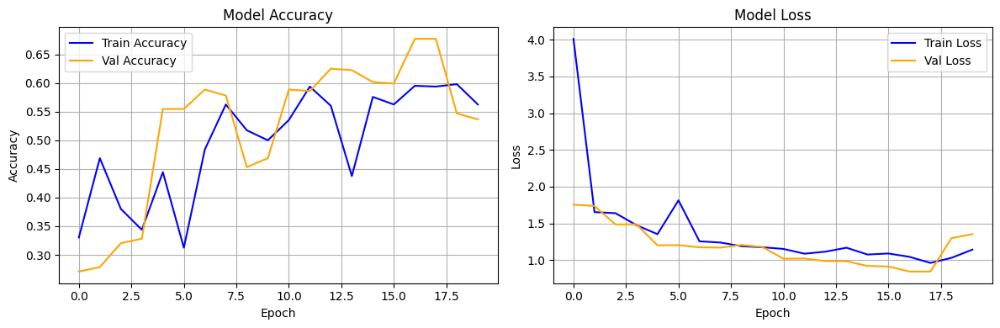

Test Accuracy: 0.6235
Test Loss: 0.8820
14/14 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step
Classification Report:
               precision    recall  f1-score   support

       tulip       0.63      0.34      0.44        92
   sunflower       0.59      0.97      0.73        75
        rose       0.45      0.55      0.49        76
   dandelion       0.71      0.64      0.67        98
       daisy       0.84      0.67      0.74        76

    accuracy                           0.62       417
   macro avg       0.64      0.64      0.62       417
weighted avg       0.65      0.62      0.61       417



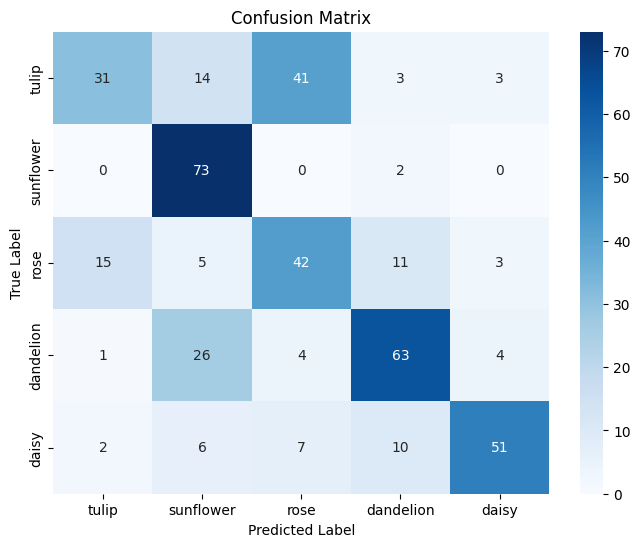

In [ ]:
# Plot loss dan accuracy
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

ax1.plot(history.history['accuracy'], label='Train Accuracy', color='blue')
ax1.plot(history.history['val_accuracy'], label='Val Accuracy', color='orange')
ax1.set_title('Model Accuracy')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Accuracy')
ax1.legend()
ax1.grid(True)

ax2.plot(history.history['loss'], label='Train Loss', color='blue')
ax2.plot(history.history['val_loss'], label='Val Loss', color='orange')
ax2.set_title('Model Loss')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Loss')
ax2.legend()
ax2.grid(True)

plt.tight_layout()
plt.show()

# Evaluasi test set
num_test_steps = (test_generator.samples + BATCH_SIZE - 1) // BATCH_SIZE

test_loss, test_accuracy = model.evaluate(test_generator, steps=num_test_steps, verbose=0)
print(f"Test Accuracy: {test_accuracy:.4f}")
print(f"Test Loss: {test_loss:.4f}")

# Classification Report
test_generator.reset()
y_pred = model.predict(test_generator, steps=num_test_steps)
y_pred_classes = np.argmax(y_pred, axis=1)

y_true = test_generator.classes

min_len = min(len(y_true), len(y_pred_classes))
y_true = y_true[:min_len]
y_pred_classes = y_pred_classes[:min_len]

report = classification_report(y_true, y_pred_classes, target_names=classes)
print("Classification Report:\n", report)

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred_classes)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

In [ ]:
# Prediksi pada sample random dari test set (50 gambar)
test_files = []
for cls in classes:
    class_path = os.path.join(test_dir, cls)
    files = [f for f in os.listdir(class_path)
             if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    if files:
        selected = random.sample(files, min(10, len(files)))  # max 10 per kelas
        test_files.extend([(os.path.join(class_path, f), cls) for f in selected])

random.shuffle(test_files)
selected_test_files = test_files[:50]

print("50 gambar random dari test set dipilih:")
for i, (file_path, cls) in enumerate(selected_test_files):
    print(f"{i+1}. {os.path.basename(file_path)} (Kelas: {cls})")

50 gambar random dari test set dipilih:
1. 7469617666_0e1a014917.jpg (Kelas: dandelion)
2. 8838914676_8ef4db7f50_n.jpg (Kelas: tulip)
3. 5231868667_f0baa71feb_n.jpg (Kelas: sunflower)
4. 13514136074_ab1b827e4f.jpg (Kelas: tulip)
5. 3326037909_b5ae370722_n.jpg (Kelas: daisy)
6. 17282288501_e8738c9cfb_n.jpg (Kelas: tulip)
7. 16265883604_92be82b973.jpg (Kelas: tulip)
8. 7295618968_c08a326cc1_m.jpg (Kelas: dandelion)
9. 4713958242_fbcfe9a61b_m.jpg (Kelas: dandelion)
10. 7166552648_28b6dce578.jpg (Kelas: tulip)
11. 13888320717_d2919a879b_m.jpg (Kelas: tulip)
12. 4648680921_80dfc4f12a.jpg (Kelas: rose)
13. 15184419268_7230e9728e.jpg (Kelas: rose)
14. 20580471306_ab5a011b15_n.jpg (Kelas: daisy)
15. 7377004908_5bc0cde347_n.jpg (Kelas: daisy)
16. 14507818175_05219b051c_m.jpg (Kelas: daisy)
17. 4893356345_24d67eff9f_m.jpg (Kelas: dandelion)
18. 7416083788_fcb4c4f27e_n.jpg (Kelas: daisy)
19. 11124381625_24b17662bd_n.jpg (Kelas: dandelion)
20. 9825716455_f12bcc8d4e_n.jpg (Kelas: sunflower)
21. 574

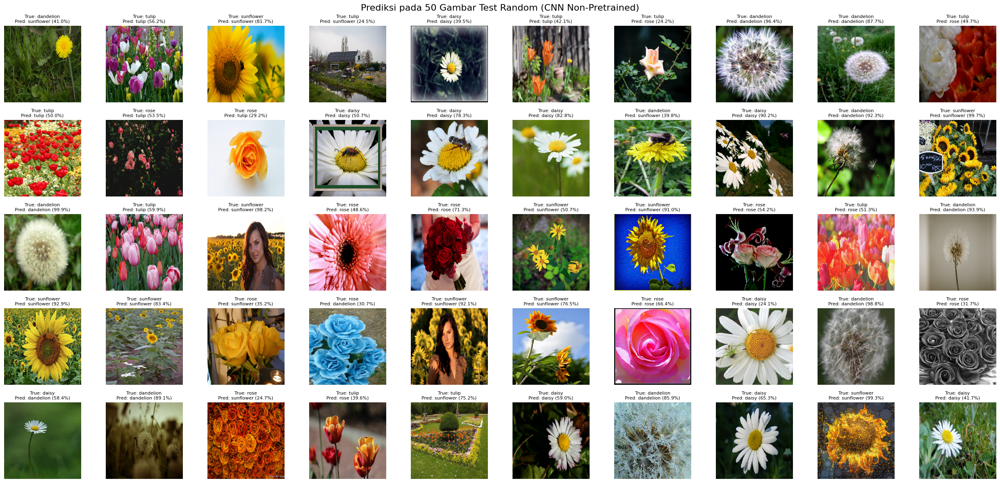

Akurasi prediksi pada 50 sample: 36/50 (72%)


In [ ]:
# Visualisasi prediksi
fig, axes = plt.subplots(5, 10, figsize=(25, 12))
axes = axes.ravel()

pred_results = []

for i, (file_path, true_cls) in enumerate(selected_test_files):
    img = load_img(file_path, target_size=IMG_SIZE)
    img_array = img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)

    pred = model.predict(img_array, verbose=0)
    pred_cls = classes[np.argmax(pred)]
    confidence = np.max(pred) * 100

    pred_results.append((true_cls, pred_cls))

    axes[i].imshow(img)
    axes[i].set_title(
        f'True: {true_cls}\nPred: {pred_cls} ({confidence:.1f}%)',
        fontsize=8
    )
    axes[i].axis('off')

plt.suptitle('Prediksi pada 50 Gambar Test Random (CNN Non-Pretrained)', fontsize=16)
plt.tight_layout()
plt.show()


# Hitung akurasi
correct = sum(1 for true_cls, pred_cls in pred_results if true_cls == pred_cls)
print(f"Akurasi prediksi pada 50 sample: {correct}/50 ({correct*2:.0f}%)")

# Pre-Trained 1 (MobileNetV2)

In [ ]:
import os
import zipfile
import shutil
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from collections import Counter
import math

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

from google.colab import drive

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

print("Semua library berhasil diimpor!")

Semua library berhasil diimpor!


In [ ]:
drive.mount('/content/drive')

# Path dataset asli
dataset_path = '/content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/'

# Kelas dataset
classes = ['tulip', 'sunflower', 'rose', 'dandelion', 'daisy']

# Cek isi folder dataset
print("Isi folder dataset:")
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    if os.path.exists(class_path):
        num_files = len([f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
        print(f"Kelas {cls}: {num_files} gambar")
    else:
        print(f"Warning: Folder {cls} tidak ditemukan di {dataset_path}. Periksa struktur folder!")

base_dir = dataset_path
print(f"\nDataset sumber: {base_dir}")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Isi folder dataset:
Kelas tulip: 607 gambar
Kelas sunflower: 495 gambar
Kelas rose: 497 gambar
Kelas dandelion: 646 gambar
Kelas daisy: 501 gambar

Dataset sumber: /content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/


In [ ]:
# Buat struktur folder untuk train, val, test
dataset_dir = '/content/structured_dataset_mobilenet_no_finetune'
train_dir = os.path.join(dataset_dir, 'train')
val_dir = os.path.join(dataset_dir, 'val')
test_dir = os.path.join(dataset_dir, 'test')

for split in ['train', 'val', 'test']:
    split_path = os.path.join(dataset_dir, split)
    os.makedirs(split_path, exist_ok=True)
    for cls in classes:
        os.makedirs(os.path.join(split_path, cls), exist_ok=True)

print("Struktur folder train, val, dan test berhasil dibuat!")
print(f"Dataset sumber: {base_dir}")

Struktur folder train, val, dan test berhasil dibuat!
Dataset sumber: /content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/


In [ ]:
train_ratio = 0.70
val_ratio = 0.15
test_ratio = 0.15

def split_dataset(base_dir, train_dir, val_dir, test_dir, classes, train_ratio, val_ratio, test_ratio):
    for cls in classes:
        class_path = os.path.join(base_dir, cls)
        if not os.path.exists(class_path):
            print(f"Error: Folder {cls} tidak ditemukan di {base_dir}. Periksa langkah 2.")
            continue
        files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

        random.shuffle(files)

        total = len(files)
        train_size = int(total * train_ratio)
        val_size = int(total * val_ratio)

        train_files = files[:train_size]
        val_files = files[train_size:train_size + val_size]
        test_files = files[train_size + val_size:]

        # Copy files ke folder split
        for file in train_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(train_dir, cls, file))

        for file in val_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(val_dir, cls, file))

        for file in test_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(test_dir, cls, file))

        print(f"Kelas {cls}: Train={len(train_files)}, Val={len(val_files)}, Test={len(test_files)}")

split_dataset(base_dir, train_dir, val_dir, test_dir, classes, train_ratio, val_ratio, test_ratio)

print("Dataset berhasil dibagi!")

Kelas tulip: Train=424, Val=91, Test=92
Kelas sunflower: Train=346, Val=74, Test=75
Kelas rose: Train=347, Val=74, Test=76
Kelas dandelion: Train=452, Val=96, Test=98
Kelas daisy: Train=350, Val=75, Test=76
Dataset berhasil dibagi!


Total dataset asli: 2746
Train: 1919 (69.9%)
Val: 410 (14.9%)
Test: 417 (15.2%)


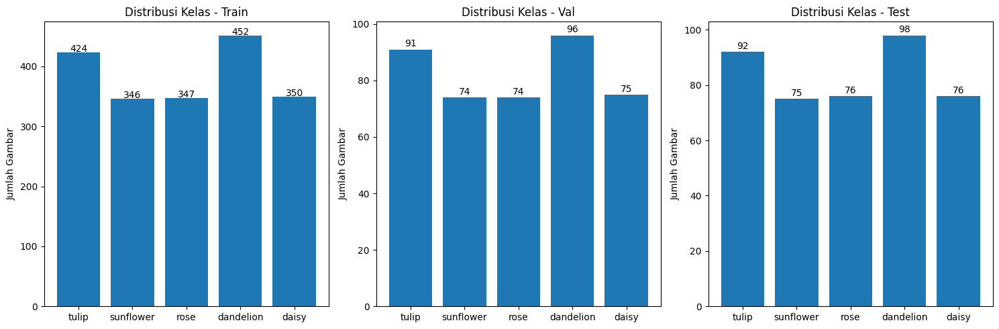


Ukuran gambar sample (10 per kelas dari train asli):
                                                                                                                             Ukuran
Kelas                                                                                                                              
daisy      [(320, 240), (500, 332), (320, 213), (240, 216), (320, 240), (320, 213), (320, 199), (320, 213), (320, 213), (320, 221)]
dandelion  [(320, 240), (500, 313), (320, 273), (500, 333), (500, 333), (225, 240), (500, 331), (189, 240), (500, 333), (500, 333)]
rose       [(320, 240), (500, 333), (211, 240), (178, 240), (320, 228), (500, 333), (500, 333), (320, 240), (320, 240), (500, 313)]
sunflower  [(180, 240), (320, 239), (500, 333), (320, 240), (500, 281), (500, 334), (320, 240), (320, 240), (500, 333), (500, 331)]
tulip      [(500, 333), (320, 211), (320, 240), (320, 213), (500, 241), (320, 240), (320, 212), (500, 334), (500, 333), (320, 240)]


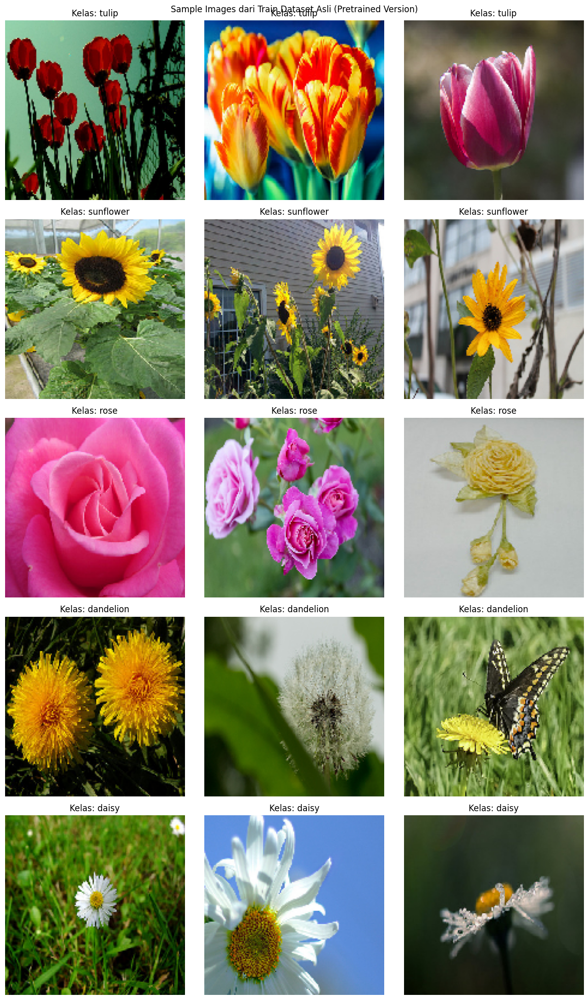

In [ ]:
def count_files(directory):
    counts = {}
    for split in ['train', 'val', 'test']:
        split_path = os.path.join(directory, split)
        counts[split] = {}
        for cls in classes:
            class_path = os.path.join(split_path, cls)
            counts[split][cls] = len([f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
    return counts

counts = count_files(dataset_dir)

total_train = sum(counts['train'].values())
total_val = sum(counts['val'].values())
total_test = sum(counts['test'].values())
total_dataset = total_train + total_val + total_test

print(f"Total dataset asli: {total_dataset}")
print(f"Train: {total_train} ({total_train/total_dataset*100:.1f}%)")
print(f"Val: {total_val} ({total_val/total_dataset*100:.1f}%)")
print(f"Test: {total_test} ({total_test/total_dataset*100:.1f}%)")

# Plot distribusi kelas
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, split in enumerate(['train', 'val', 'test']):
    cls_counts = list(counts[split].values())
    axes[i].bar(classes, cls_counts)
    axes[i].set_title(f'Distribusi Kelas - {split.capitalize()}')
    axes[i].set_ylabel('Jumlah Gambar')
    for j, v in enumerate(cls_counts):
        axes[i].text(j, v + 1, str(v), ha='center')

plt.tight_layout()
plt.show()

# Analisis ukuran gambar sample
def get_image_sizes(base_dir, classes, num_samples=10):
    sizes = []
    for cls in classes:
        class_path = os.path.join(base_dir, cls)
        files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:num_samples]
        for file in files:
            try:
                img = Image.open(os.path.join(class_path, file))
                sizes.append((cls, img.size, img.mode))
            except Exception as e:
                print(f"Error membaca {file}: {e}")
    return sizes

train_base = os.path.join(dataset_dir, 'train')
sizes = get_image_sizes(train_base, classes)
df_sizes = pd.DataFrame(sizes, columns=['Kelas', 'Ukuran', 'Mode'])
print("\nUkuran gambar sample (10 per kelas dari train asli):")
print(df_sizes.groupby('Kelas').agg({'Ukuran': list}).to_string())

# Sample images
fig, axes = plt.subplots(5, 3, figsize=(12, 20))
axes = axes.ravel()
sample_files = []
for cls in classes:
    class_path = os.path.join(train_base, cls)
    files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:3]
    sample_files.extend([(os.path.join(class_path, f), cls) for f in files])

for i, (file_path, cls) in enumerate(sample_files):
    try:
        img = load_img(file_path, target_size=(150, 150))
        axes[i].imshow(img)
        axes[i].set_title(f'Kelas: {cls}')
        axes[i].axis('off')
    except Exception as e:
        axes[i].text(0.5, 0.5, f'Error: {e}', ha='center', va='center')
        axes[i].set_title(f'Kelas: {cls}')

plt.suptitle('Sample Images dari Train Dataset Asli (No Finetune MobileNetV2)')
plt.tight_layout()
plt.show()

In [ ]:
# Augmentasi train set hingga ~1100 per kelas
IMG_SIZE = (224, 224)
BATCH_SIZE = 16
TARGET_PER_CLASS = 1100

# Hapus isi train folder lama
for cls in classes:
    cls_path = os.path.join(train_dir, cls)
    for file in os.listdir(cls_path):
        os.remove(os.path.join(cls_path, file))

print("Memulai augmentasi train set...")

augment_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=15,
    width_shift_range=0.15,
    height_shift_range=0.15,
    horizontal_flip=True,
    zoom_range=0.15,
    brightness_range=[0.85, 1.15],
    fill_mode='nearest'
)

for cls in classes:
    cls_path = os.path.join(train_dir, cls)
    needed_aug = max(0, TARGET_PER_CLASS - len([f for f in os.listdir(os.path.join(base_dir, cls)) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]))

    temp_gen = augment_datagen.flow_from_directory(
        base_dir,
        classes=[cls],
        target_size=IMG_SIZE,
        batch_size=1,
        shuffle=True,
        save_to_dir=cls_path,
        save_prefix='aug',
        save_format='jpeg'
    )

    generated = 0
    while generated < needed_aug:
        batch = next(temp_gen)
        generated += 1
        if generated % 100 == 0:
            print(f"Kelas {cls}: Generated {generated}/{needed_aug}")

    # Tambah original files
    original_cls_path = os.path.join(base_dir, cls)
    original_files = [f for f in os.listdir(original_cls_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    for file in original_files:
        shutil.copy(os.path.join(original_cls_path, file), os.path.join(cls_path, file))

    # Trim if over
    all_files = [f for f in os.listdir(cls_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    random.shuffle(all_files)
    if len(all_files) > TARGET_PER_CLASS:
        excess = all_files[TARGET_PER_CLASS:]
        for ex in excess:
            os.remove(os.path.join(cls_path, ex))

    final_count = len(all_files)
    print(f"Kelas {cls}: Final train = {final_count} gambar")

print("Augmentasi selesai!")

Memulai augmentasi train set...
Found 607 images belonging to 1 classes.
Kelas tulip: Generated 100/1100
Kelas tulip: Generated 200/1100
Kelas tulip: Generated 300/1100
Kelas tulip: Generated 400/1100
Kelas tulip: Generated 500/1100
Kelas tulip: Generated 600/1100
Kelas tulip: Generated 700/1100
Kelas tulip: Generated 800/1100
Kelas tulip: Generated 900/1100
Kelas tulip: Generated 1000/1100
Kelas tulip: Generated 1100/1100
Kelas tulip: Augmented train = 1100 gambar
Found 495 images belonging to 1 classes.
Kelas sunflower: Generated 100/1100
Kelas sunflower: Generated 200/1100
Kelas sunflower: Generated 300/1100
Kelas sunflower: Generated 400/1100
Kelas sunflower: Generated 500/1100
Kelas sunflower: Generated 600/1100
Kelas sunflower: Generated 700/1100
Kelas sunflower: Generated 800/1100
Kelas sunflower: Generated 900/1100
Kelas sunflower: Generated 1000/1100
Kelas sunflower: Generated 1100/1100
Kelas sunflower: Augmented train = 1100 gambar
Found 497 images belonging to 1 classes.
Kel

In [ ]:
# Data generators dengan MobileNetV2 preprocessing
def custom_preprocess(image):
    image = np.array(image, dtype=np.float32)
    return preprocess_input(image)

train_datagen = ImageDataGenerator(
    preprocessing_function=custom_preprocess,
    rotation_range=15,
    width_shift_range=0.15,
    height_shift_range=0.15,
    horizontal_flip=True,
    zoom_range=0.15,
    fill_mode='nearest'
)

val_datagen = ImageDataGenerator(preprocessing_function=custom_preprocess)
test_datagen = ImageDataGenerator(preprocessing_function=custom_preprocess)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=True
)

val_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=False
)

print("Generator berhasil dibuat!")
print(f"Train samples: {train_generator.samples}")
print(f"Val samples: {val_generator.samples}")
print(f"Test samples: {test_generator.samples}")

Found 5500 images belonging to 5 classes.
Found 410 images belonging to 5 classes.
Found 417 images belonging to 5 classes.
Generator berhasil dibuat dengan pre-processing dan augmentation on-the-fly!
Train samples: 5500
Val samples: 410
Test samples: 417


In [ ]:
# Model MobileNetV2 tanpa fine-tuning (base frozen)
base_model = MobileNetV2(
    weights='imagenet',
    include_top=False,
    input_shape=(*IMG_SIZE, 3)
)

base_model.trainable = False  # No fine-tuning

model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    BatchNormalization(),
    Dropout(0.3),
    Dense(512, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(256, activation='relu'),
    Dropout(0.2),
    Dense(len(classes), activation='softmax')
])

model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

print("MobileNetV2 model (no fine-tuning) dibangun!")

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 5)              │           645 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,422,597 (9.24 MB)

 Trainable params: 164,613 (643.02 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

Model Transfer Learning (MobileNetV2) berhasil dibangun!


In [ ]:
# Single training loop with 20 epochs
print("=== Training Top Layers (20 Epochs, No Fine-Tuning) ===")
callbacks = [
    EarlyStopping(monitor='val_accuracy', patience=7, restore_best_weights=True, mode='max'),
    ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=4, min_lr=1e-7, verbose=1),
    ModelCheckpoint('/content/best_mobilenet_no_finetune.keras', monitor='val_accuracy', save_best_only=True, verbose=1)
]

EPOCHS = 20

# Fixed steps
steps_per_epoch = math.ceil(train_generator.samples / BATCH_SIZE)
val_steps = math.ceil(val_generator.samples / BATCH_SIZE)

history = model.fit(
    train_generator,
    steps_per_epoch=steps_per_epoch,
    epochs=EPOCHS,
    validation_data=val_generator,
    validation_steps=val_steps,
    callbacks=callbacks,
    verbose=1
)

# Load best model
best_model = load_model('/content/best_mobilenet_no_finetune.keras')

# Save
model_save_dir = '/content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/MODEL/'
os.makedirs(model_save_dir, exist_ok=True)
best_model.save(os.path.join(model_save_dir, 'pretrained_mobilenetv2_no_finetune.keras'))
print("Pelatihan selesai (20 epochs, no fine-tuning)! Best model disimpan ke Drive.")

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 107s 501ms/step - accuracy: 0.5875 - loss: 1.0656 - val_accuracy: 0.8359 - val_loss: 0.4319 - learning_rate: 0.0010
Epoch 2/20
  1/171 ━━━━━━━━━━━━━━━━━━━━ 6s 38ms/step - accuracy: 0.8438 - loss: 0.4365

/usr/local/lib/python3.12/dist-packages/keras/src/trainers/epoch_iterator.py:116: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()


171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8438 - loss: 0.4365 - val_accuracy: 0.8516 - val_loss: 0.4324 - learning_rate: 0.0010
Epoch 3/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 69s 404ms/step - accuracy: 0.7710 - loss: 0.6042 - val_accuracy: 0.8646 - val_loss: 0.3653 - learning_rate: 0.0010
Epoch 4/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8438 - loss: 0.4623 - val_accuracy: 0.8646 - val_loss: 0.3625 - learning_rate: 0.0010
Epoch 5/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 67s 390ms/step - accuracy: 0.7939 - loss: 0.5389 - val_accuracy: 0.8281 - val_loss: 0.3962 - learning_rate: 0.0010
Epoch 6/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7812 - loss: 0.4541 - val_accuracy: 0.8229 - val_loss: 0.4157 - learning_rate: 0.0010
Epoch 7/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 68s 399ms/step - accuracy: 0.7997 - loss: 0.4976 - val_accuracy: 0.8750 - val_loss: 0.3190 - learning_rate: 0.0010
Epoch 8/20
171/171 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - accuracy: 0.7500 - loss: 0.8011 - va

Pelatihan selesai! Model 'pretrained_mobilenetv2.h5' disimpan ke Drive.


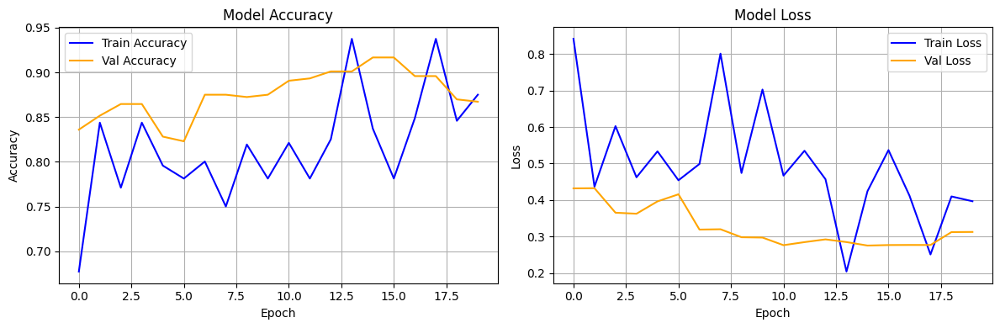

Test Accuracy: 0.9137
Test Loss: 0.2866
14/14 ━━━━━━━━━━━━━━━━━━━━ 10s 371ms/step
Classification Report:
               precision    recall  f1-score   support

       tulip       0.86      0.90      0.88        92
   sunflower       0.97      0.88      0.92        75
        rose       0.83      0.92      0.88        76
   dandelion       0.98      0.94      0.96        98
       daisy       0.95      0.92      0.93        76

    accuracy                           0.91       417
   macro avg       0.92      0.91      0.91       417
weighted avg       0.92      0.91      0.91       417



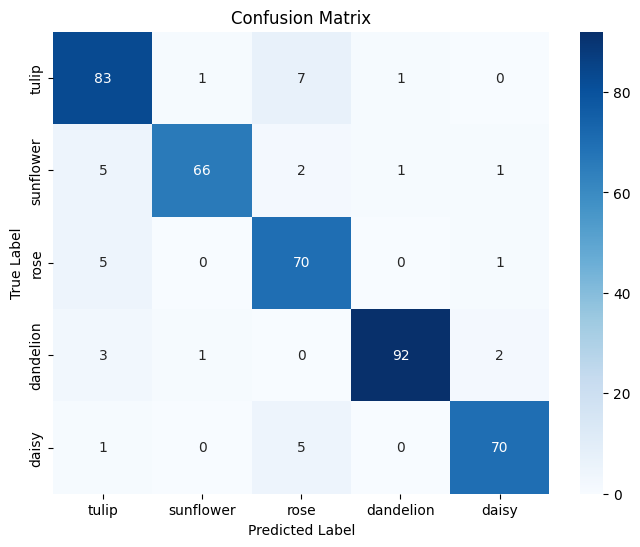

In [ ]:
# Plot history
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

ax1.plot(history.history['accuracy'], label='Train Accuracy')
ax1.plot(history.history['val_accuracy'], label='Val Accuracy')
ax1.set_title('Model Accuracy')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Accuracy')
ax1.legend()
ax1.grid(True)

ax2.plot(history.history['loss'], label='Train Loss')
ax2.plot(history.history['val_loss'], label='Val Loss')
ax2.set_title('Model Loss')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Loss')
ax2.legend()
ax2.grid(True)

plt.tight_layout()
plt.show()

# Evaluation with best model
num_test_steps = math.ceil(test_generator.samples / BATCH_SIZE)

test_loss, test_accuracy = best_model.evaluate(test_generator, steps=num_test_steps, verbose=0)
print(f"Best Model Test Accuracy: {test_accuracy:.4f}")
print(f"Best Model Test Loss: {test_loss:.4f}")

# Classification Report
test_generator.reset()
y_pred = best_model.predict(test_generator, steps=num_test_steps)
y_pred_classes = np.argmax(y_pred, axis=1)

y_true = test_generator.classes

min_len = min(len(y_true), len(y_pred_classes))
y_true = y_true[:min_len]
y_pred_classes = y_pred_classes[:min_len]

report = classification_report(y_true, y_pred_classes, target_names=classes)
print("Classification Report:\n", report)

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred_classes)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.title('Confusion Matrix (No Fine-Tune MobileNetV2)')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

In [ ]:
# Prediksi pada 50 sample random dari test set
test_files = []
for cls in classes:
    class_path = os.path.join(test_dir, cls)
    files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    if files:
        selected = random.sample(files, min(10, len(files)))  # 10 per class for 50 total
        test_files.extend([(os.path.join(class_path, f), cls) for f in selected])

random.shuffle(test_files)
selected_test_files = test_files[:50]

print("50 gambar random dari test set dipilih untuk prediksi.")

50 gambar random dari test set dipilih:
1. 4895719476_bd3b6bd6fd_n.jpg (Kelas: sunflower)
2. 13968424321_1d89b33a9f_n.jpg (Kelas: dandelion)
3. 9262004825_710346cde9_n.jpg (Kelas: dandelion)
4. 3422228549_f147d6e642.jpg (Kelas: rose)
5. 18684594849_7dd3634f5e_n.jpg (Kelas: daisy)
6. 4534460263_8e9611db3c_n.jpg (Kelas: daisy)
7. 18243351371_5fda92ac0a_n.jpg (Kelas: dandelion)
8. 4890424315_6a59696357_n.jpg (Kelas: daisy)
9. 8462246855_1bdfee7478.jpg (Kelas: rose)
10. 9338237628_4d2547608c.jpg (Kelas: rose)
11. 17062080069_36ac7907d2_n.jpg (Kelas: rose)
12. 5951665793_8ae4807cbd_n.jpg (Kelas: sunflower)
13. 4231745228_ece86330d9.jpg (Kelas: rose)
14. 8622237974_b362574785_n.jpg (Kelas: tulip)
15. 15973657966_d6f6005539_n.jpg (Kelas: sunflower)
16. 7377004908_5bc0cde347_n.jpg (Kelas: daisy)
17. 9355706808_a9a723a8e8_n.jpg (Kelas: rose)
18. 4846786944_2832c5c8b8.jpg (Kelas: sunflower)
19. 4553266758_09d4dbdac9_n.jpg (Kelas: rose)
20. 7416083788_fcb4c4f27e_n.jpg (Kelas: daisy)
21. 213497899

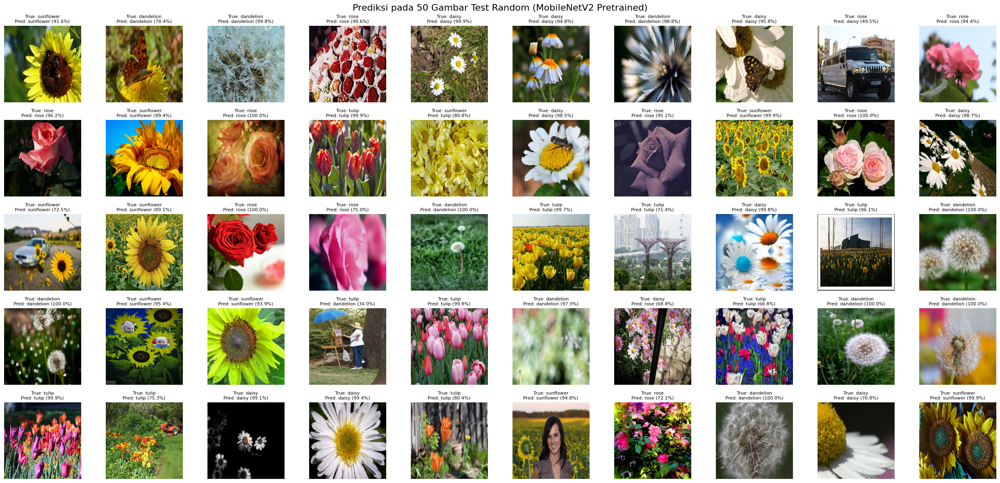

Akurasi prediksi pada 50 sample: 46/50 (92%)


In [ ]:
# Visualisasi dan prediksi pada 50 sample menggunakan best model
pred_results = []
fig, axes = plt.subplots(10, 5, figsize=(20, 40))  # 10 rows x 5 cols for 50 images
axes = axes.ravel()

for i, (file_path, true_cls) in enumerate(selected_test_files):
    img = load_img(file_path, target_size=IMG_SIZE)
    img_array = img_to_array(img)
    img_array = preprocess_input(img_array)
    img_array = np.expand_dims(img_array, axis=0)

    pred = best_model.predict(img_array, verbose=0)
    pred_cls = classes[np.argmax(pred)]
    confidence = np.max(pred) * 100

    pred_results.append((true_cls, pred_cls))

    orig_img = load_img(file_path, target_size=IMG_SIZE)
    axes[i].imshow(orig_img)
    axes[i].set_title(f'True: {true_cls}\nPred: {pred_cls} ({confidence:.1f}%)', fontsize=8)
    axes[i].axis('off')

plt.suptitle('Prediksi pada 50 Gambar Test Random (Best MobileNetV2 Model)', fontsize=16)
plt.tight_layout()
plt.show()

correct = sum(1 for true_cls, pred_cls in pred_results if true_cls == pred_cls)
print(f"Akurasi prediksi pada 50 sample: {correct}/50 ({correct/50*100:.1f}%)")

# Pre-Trained 2 (Resnet50)

In [ ]:
import os
import zipfile
import shutil
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from collections import Counter
import math

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

from google.colab import drive

random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)

print("Semua library berhasil diimpor!")

Semua library berhasil diimpor!


In [ ]:
drive.mount('/content/drive')

# Path dataset asli
dataset_path = '/content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/'

# Kelas dataset
classes = ['tulip', 'sunflower', 'rose', 'dandelion', 'daisy']

# Cek isi folder dataset
print("Isi folder dataset:")
for cls in classes:
    class_path = os.path.join(dataset_path, cls)
    if os.path.exists(class_path):
        num_files = len([f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
        print(f"Kelas {cls}: {num_files} gambar")
    else:
        print(f"Warning: Folder {cls} tidak ditemukan di {dataset_path}. Periksa struktur folder!")

base_dir = dataset_path
print(f"\nDataset sumber: {base_dir}")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Isi folder dataset:
Kelas tulip: 607 gambar
Kelas sunflower: 495 gambar
Kelas rose: 497 gambar
Kelas dandelion: 646 gambar
Kelas daisy: 501 gambar

Dataset sumber: /content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/


In [ ]:
# Buat struktur folder untuk train, val, test
dataset_dir = '/content/structured_dataset_resnet_no_finetune'
train_dir = os.path.join(dataset_dir, 'train')
val_dir = os.path.join(dataset_dir, 'val')
test_dir = os.path.join(dataset_dir, 'test')

for split in ['train', 'val', 'test']:
    split_path = os.path.join(dataset_dir, split)
    os.makedirs(split_path, exist_ok=True)
    for cls in classes:
        os.makedirs(os.path.join(split_path, cls), exist_ok=True)

print("Struktur folder train, val, dan test berhasil dibuat!")
print(f"Dataset sumber: {base_dir}")

Struktur folder train, val, dan test berhasil dibuat!
Dataset sumber: /content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/DATASET/flower/


In [ ]:
train_ratio = 0.70
val_ratio = 0.15
test_ratio = 0.15

def split_dataset(base_dir, train_dir, val_dir, test_dir, classes, train_ratio, val_ratio, test_ratio):
    for cls in classes:
        class_path = os.path.join(base_dir, cls)
        if not os.path.exists(class_path):
            print(f"Error: Folder {cls} tidak ditemukan di {base_dir}. Periksa langkah 2.")
            continue
        files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

        random.shuffle(files)

        total = len(files)
        train_size = int(total * train_ratio)
        val_size = int(total * val_ratio)

        train_files = files[:train_size]
        val_files = files[train_size:train_size + val_size]
        test_files = files[train_size + val_size:]

        # Copy files ke folder split
        for file in train_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(train_dir, cls, file))

        for file in val_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(val_dir, cls, file))

        for file in test_files:
            shutil.copy(os.path.join(class_path, file), os.path.join(test_dir, cls, file))

        print(f"Kelas {cls}: Train={len(train_files)}, Val={len(val_files)}, Test={len(test_files)}")

split_dataset(base_dir, train_dir, val_dir, test_dir, classes, train_ratio, val_ratio, test_ratio)

print("Dataset berhasil dibagi!")

Kelas tulip: Train=424, Val=91, Test=92
Kelas sunflower: Train=346, Val=74, Test=75
Kelas rose: Train=347, Val=74, Test=76
Kelas dandelion: Train=452, Val=96, Test=98
Kelas daisy: Train=350, Val=75, Test=76
Dataset berhasil dibagi!


Total dataset asli: 2746
Train: 1919 (69.9%)
Val: 410 (14.9%)
Test: 417 (15.2%)


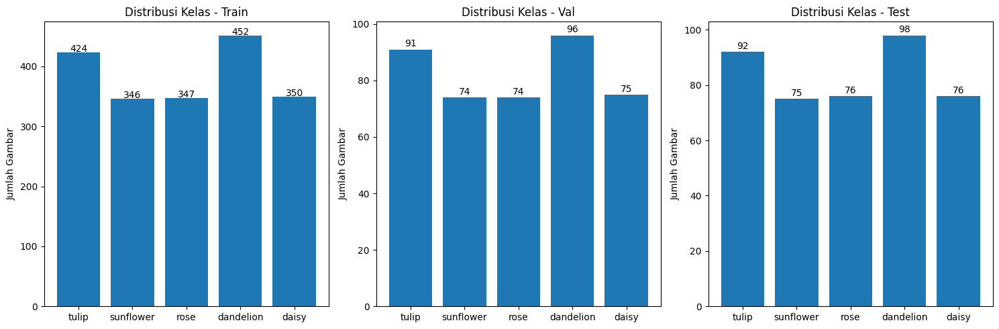


Ukuran gambar sample (10 per kelas dari train asli):
                                                                                                                             Ukuran
Kelas                                                                                                                              
daisy      [(320, 240), (500, 332), (320, 213), (240, 216), (320, 240), (320, 213), (320, 199), (320, 213), (320, 213), (320, 221)]
dandelion  [(320, 240), (500, 313), (320, 273), (500, 333), (500, 333), (225, 240), (500, 331), (189, 240), (500, 333), (500, 333)]
rose       [(320, 240), (500, 333), (211, 240), (178, 240), (320, 228), (500, 333), (500, 333), (320, 240), (320, 240), (500, 313)]
sunflower  [(180, 240), (320, 239), (500, 333), (320, 240), (500, 281), (500, 334), (320, 240), (320, 240), (500, 333), (500, 331)]
tulip      [(500, 333), (320, 211), (320, 240), (320, 213), (500, 241), (320, 240), (320, 212), (500, 334), (500, 333), (320, 240)]


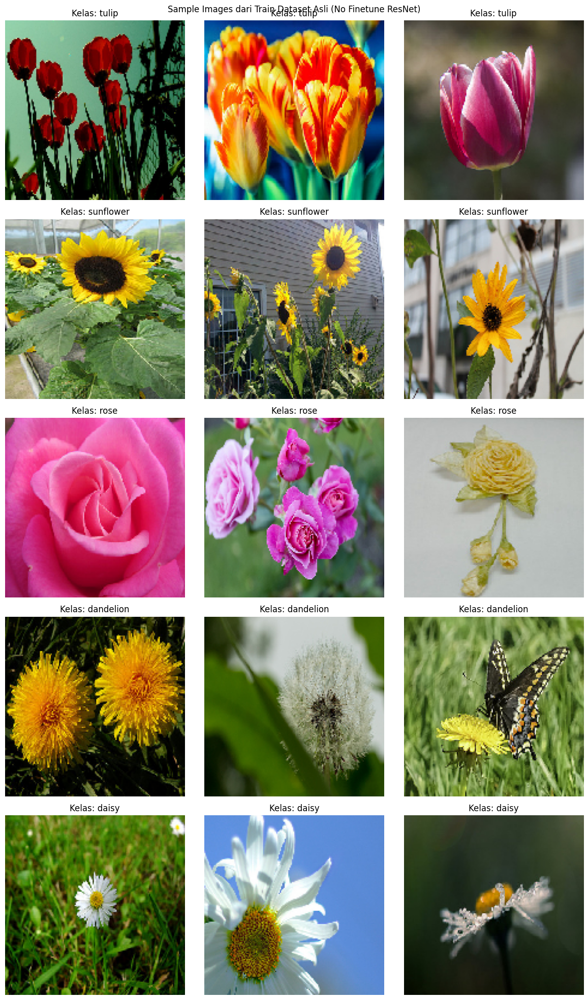

In [ ]:
def count_files(directory):
    counts = {}
    for split in ['train', 'val', 'test']:
        split_path = os.path.join(directory, split)
        counts[split] = {}
        for cls in classes:
            class_path = os.path.join(split_path, cls)
            counts[split][cls] = len([f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))])
    return counts

counts = count_files(dataset_dir)

total_train = sum(counts['train'].values())
total_val = sum(counts['val'].values())
total_test = sum(counts['test'].values())
total_dataset = total_train + total_val + total_test

print(f"Total dataset asli: {total_dataset}")
print(f"Train: {total_train} ({total_train/total_dataset*100:.1f}%)")
print(f"Val: {total_val} ({total_val/total_dataset*100:.1f}%)")
print(f"Test: {total_test} ({total_test/total_dataset*100:.1f}%)")

# Plot distribusi kelas
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
for i, split in enumerate(['train', 'val', 'test']):
    cls_counts = list(counts[split].values())
    axes[i].bar(classes, cls_counts)
    axes[i].set_title(f'Distribusi Kelas - {split.capitalize()}')
    axes[i].set_ylabel('Jumlah Gambar')
    for j, v in enumerate(cls_counts):
        axes[i].text(j, v + 1, str(v), ha='center')

plt.tight_layout()
plt.show()

# Analisis ukuran gambar sample
def get_image_sizes(base_dir, classes, num_samples=10):
    sizes = []
    for cls in classes:
        class_path = os.path.join(base_dir, cls)
        files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:num_samples]
        for file in files:
            try:
                img = Image.open(os.path.join(class_path, file))
                sizes.append((cls, img.size, img.mode))
            except Exception as e:
                print(f"Error membaca {file}: {e}")
    return sizes

train_base = os.path.join(dataset_dir, 'train')
sizes = get_image_sizes(train_base, classes)
df_sizes = pd.DataFrame(sizes, columns=['Kelas', 'Ukuran', 'Mode'])
print("\nUkuran gambar sample (10 per kelas dari train asli):")
print(df_sizes.groupby('Kelas').agg({'Ukuran': list}).to_string())

# Sample images
fig, axes = plt.subplots(5, 3, figsize=(12, 20))
axes = axes.ravel()
sample_files = []
for cls in classes:
    class_path = os.path.join(train_base, cls)
    files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:3]
    sample_files.extend([(os.path.join(class_path, f), cls) for f in files])

for i, (file_path, cls) in enumerate(sample_files):
    try:
        img = load_img(file_path, target_size=(150, 150))
        axes[i].imshow(img)
        axes[i].set_title(f'Kelas: {cls}')
        axes[i].axis('off')
    except Exception as e:
        axes[i].text(0.5, 0.5, f'Error: {e}', ha='center', va='center')
        axes[i].set_title(f'Kelas: {cls}')

plt.suptitle('Sample Images dari Train Dataset Asli (No Finetune ResNet)')
plt.tight_layout()
plt.show()

In [ ]:
# Augmentasi train set hingga ~1100 per kelas
IMG_SIZE = (224, 224)
BATCH_SIZE = 16
TARGET_PER_CLASS = 1100

# Hapus isi train folder lama
for cls in classes:
    cls_path = os.path.join(train_dir, cls)
    for file in os.listdir(cls_path):
        os.remove(os.path.join(cls_path, file))

print("Memulai augmentasi train set...")

augment_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=15,
    width_shift_range=0.15,
    height_shift_range=0.15,
    horizontal_flip=True,
    zoom_range=0.15,
    brightness_range=[0.85, 1.15],
    fill_mode='nearest'
)

for cls in classes:
    cls_path = os.path.join(train_dir, cls)
    needed_aug = max(0, TARGET_PER_CLASS - len([f for f in os.listdir(os.path.join(base_dir, cls)) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]))

    temp_gen = augment_datagen.flow_from_directory(
        base_dir,
        classes=[cls],
        target_size=IMG_SIZE,
        batch_size=1,
        shuffle=True,
        save_to_dir=cls_path,
        save_prefix='aug',
        save_format='jpeg'
    )

    generated = 0
    while generated < needed_aug:
        batch = next(temp_gen)
        generated += 1
        if generated % 100 == 0:
            print(f"Kelas {cls}: Generated {generated}/{needed_aug}")

    # Tambah original files
    original_cls_path = os.path.join(base_dir, cls)
    original_files = [f for f in os.listdir(original_cls_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    for file in original_files:
        shutil.copy(os.path.join(original_cls_path, file), os.path.join(cls_path, file))

    # Trim if over
    all_files = [f for f in os.listdir(cls_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    random.shuffle(all_files)
    if len(all_files) > TARGET_PER_CLASS:
        excess = all_files[TARGET_PER_CLASS:]
        for ex in excess:
            os.remove(os.path.join(cls_path, ex))

    final_count = len(all_files)
    print(f"Kelas {cls}: Final train = {final_count} gambar")

print("Augmentasi selesai!")

Memulai augmentasi train set...
Found 607 images belonging to 1 classes.
Kelas tulip: Generated 100/493
Kelas tulip: Generated 200/493
Kelas tulip: Generated 300/493
Kelas tulip: Generated 400/493
Kelas tulip: Final train = 1100 gambar
Found 495 images belonging to 1 classes.
Kelas sunflower: Generated 100/605
Kelas sunflower: Generated 200/605
Kelas sunflower: Generated 300/605
Kelas sunflower: Generated 400/605
Kelas sunflower: Generated 500/605
Kelas sunflower: Generated 600/605
Kelas sunflower: Final train = 1100 gambar
Found 497 images belonging to 1 classes.
Kelas rose: Generated 100/603
Kelas rose: Generated 200/603
Kelas rose: Generated 300/603
Kelas rose: Generated 400/603
Kelas rose: Generated 500/603
Kelas rose: Generated 600/603
Kelas rose: Final train = 1100 gambar
Found 646 images belonging to 1 classes.
Kelas dandelion: Generated 100/454
Kelas dandelion: Generated 200/454
Kelas dandelion: Generated 300/454
Kelas dandelion: Generated 400/454
Kelas dandelion: Final train =

In [ ]:
# Data generators dengan ResNet preprocessing
def custom_preprocess(image):
    image = np.array(image, dtype=np.float32)
    return preprocess_input(image)

train_datagen = ImageDataGenerator(
    preprocessing_function=custom_preprocess,
    rotation_range=15,
    width_shift_range=0.15,
    height_shift_range=0.15,
    horizontal_flip=True,
    zoom_range=0.15,
    fill_mode='nearest'
)

val_datagen = ImageDataGenerator(preprocessing_function=custom_preprocess)
test_datagen = ImageDataGenerator(preprocessing_function=custom_preprocess)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=True
)

val_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    classes=classes,
    shuffle=False
)

print("Generator berhasil dibuat!")
print(f"Train samples: {train_generator.samples}")
print(f"Val samples: {val_generator.samples}")
print(f"Test samples: {test_generator.samples}")

Found 5500 images belonging to 5 classes.
Found 410 images belonging to 5 classes.
Found 417 images belonging to 5 classes.
Generator berhasil dibuat!
Train samples: 5500
Val samples: 410
Test samples: 417


In [ ]:
# Model ResNet50 tanpa fine-tuning (base frozen)
base_model = ResNet50(
    weights='imagenet',
    include_top=False,
    input_shape=(*IMG_SIZE, 3)
)

base_model.trainable = False  # No fine-tuning

model = Sequential([
    base_model,
    GlobalAveragePooling2D(),
    BatchNormalization(),
    Dropout(0.3),
    Dense(512, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(256, activation='relu'),
    Dropout(0.2),
    Dense(len(classes), activation='softmax')
])

model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

print("ResNet50 model (no fine-tuning) dibangun!")

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 7, 7, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_4      │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 2048)           │         8,192 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 512)            │     1,049,088 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 5)              │         1,285 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 24,779,653 (94.53 MB)

 Trainable params: 1,186,821 (4.53 MB)

 Non-trainable params: 23,592,832 (90.00 MB)

ResNet50 model (no fine-tuning) dibangun!


In [ ]:
# Single training loop with 20 epochs
print("=== Training Top Layers (20 Epochs, No Fine-Tuning) ===")
callbacks = [
    EarlyStopping(monitor='val_accuracy', patience=7, restore_best_weights=True, mode='max'),
    ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=4, min_lr=1e-7, verbose=1),
    ModelCheckpoint('/content/best_resnet_no_finetune.keras', monitor='val_accuracy', save_best_only=True, verbose=1)
]

EPOCHS = 20

# Fixed steps
steps_per_epoch = math.ceil(train_generator.samples / BATCH_SIZE)
val_steps = math.ceil(val_generator.samples / BATCH_SIZE)

history = model.fit(
    train_generator,
    steps_per_epoch=steps_per_epoch,
    epochs=EPOCHS,
    validation_data=val_generator,
    validation_steps=val_steps,
    callbacks=callbacks,
    verbose=1
)

# Load best model
best_model = load_model('/content/best_resnet_no_finetune.keras')

# Save
model_save_dir = '/content/drive/MyDrive/STUDI UMM/SEMESTER 7/PRAKTIKUM/UAP/MODEL/'
os.makedirs(model_save_dir, exist_ok=True)
best_model.save(os.path.join(model_save_dir, 'pretrained_resnet50_no_finetune.keras'))
print("Pelatihan selesai (20 epochs, no fine-tuning)! Best model disimpan ke Drive.")

=== Training Top Layers (20 Epochs, No Fine-Tuning) ===


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
344/344 ━━━━━━━━━━━━━━━━━━━━ 0s 241ms/step - accuracy: 0.5304 - loss: 1.2769
Epoch 1: val_accuracy improved from -inf to 0.89756, saving model to /content/best_resnet_no_finetune.keras
344/344 ━━━━━━━━━━━━━━━━━━━━ 109s 275ms/step - accuracy: 0.5308 - loss: 1.2758 - val_accuracy: 0.8976 - val_loss: 0.2914 - learning_rate: 1.0000e-04
Epoch 2/20
344/344 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step - accuracy: 0.8083 - loss: 0.5484
Epoch 2: val_accuracy improved from 0.89756 to 0.92195, saving model to /content/best_resnet_no_finetune.keras
344/344 ━━━━━━━━━━━━━━━━━━━━ 81s 235ms/step - accuracy: 0.8083 - loss: 0.5483 - val_accuracy: 0.9220 - val_loss: 0.2090 - learning_rate: 1.0000e-04
Epoch 3/20
344/344 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step - accuracy: 0.8396 - loss: 0.4542
Epoch 3: val_accuracy improved from 0.92195 to 0.94634, saving model to /content/best_resnet_no_finetune.keras
344/344 ━━━━━━━━━━━━━━━━━━━━ 80s 233ms/step - accuracy: 0.8396 - loss: 0.4542 - val_accuracy: 0.9463 - val_lo

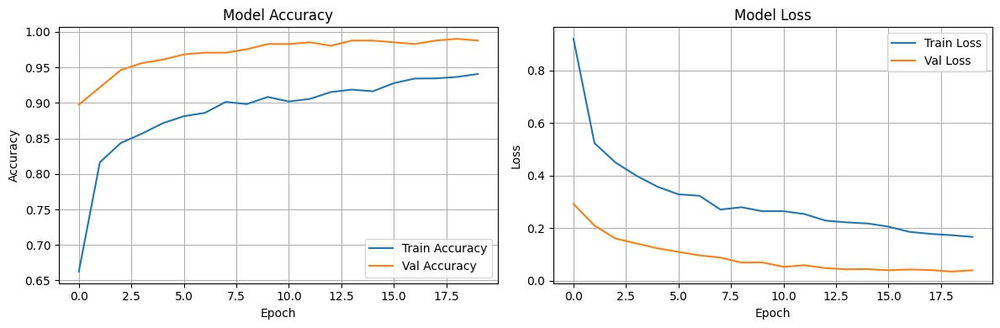

Best Model Test Accuracy: 0.9808
Best Model Test Loss: 0.0459
27/27 ━━━━━━━━━━━━━━━━━━━━ 11s 225ms/step
Classification Report:
               precision    recall  f1-score   support

       tulip       0.97      0.97      0.97        92
   sunflower       1.00      0.99      0.99        75
        rose       0.96      0.96      0.96        76
   dandelion       0.99      0.99      0.99        98
       daisy       0.99      1.00      0.99        76

    accuracy                           0.98       417
   macro avg       0.98      0.98      0.98       417
weighted avg       0.98      0.98      0.98       417



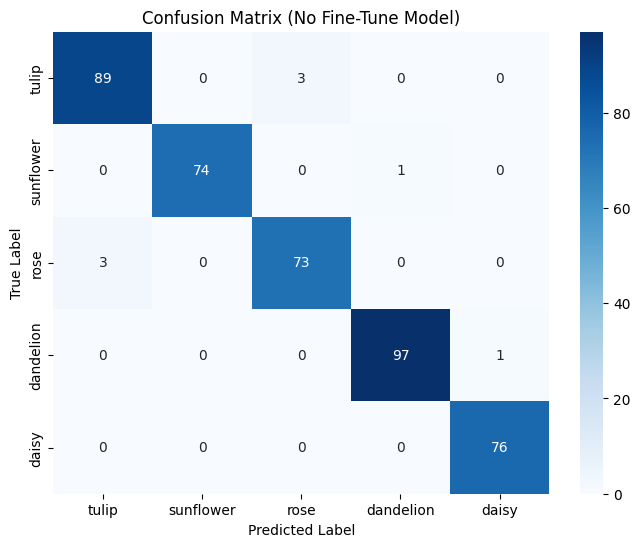

In [ ]:
# Plot history
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

ax1.plot(history.history['accuracy'], label='Train Accuracy')
ax1.plot(history.history['val_accuracy'], label='Val Accuracy')
ax1.set_title('Model Accuracy')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Accuracy')
ax1.legend()
ax1.grid(True)

ax2.plot(history.history['loss'], label='Train Loss')
ax2.plot(history.history['val_loss'], label='Val Loss')
ax2.set_title('Model Loss')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Loss')
ax2.legend()
ax2.grid(True)

plt.tight_layout()
plt.show()

# Evaluation with best model
num_test_steps = math.ceil(test_generator.samples / BATCH_SIZE)

test_loss, test_accuracy = best_model.evaluate(test_generator, steps=num_test_steps, verbose=0)
print(f"Best Model Test Accuracy: {test_accuracy:.4f}")
print(f"Best Model Test Loss: {test_loss:.4f}")

# Classification Report
test_generator.reset()
y_pred = best_model.predict(test_generator, steps=num_test_steps)
y_pred_classes = np.argmax(y_pred, axis=1)

y_true = test_generator.classes

min_len = min(len(y_true), len(y_pred_classes))
y_true = y_true[:min_len]
y_pred_classes = y_pred_classes[:min_len]

report = classification_report(y_true, y_pred_classes, target_names=classes)
print("Classification Report:\n", report)

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred_classes)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
plt.title('Confusion Matrix (No Fine-Tune Model)')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

In [ ]:
# Prediksi pada 50 sample random dari test set
test_files = []
for cls in classes:
    class_path = os.path.join(test_dir, cls)
    files = [f for f in os.listdir(class_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    if files:
        selected = random.sample(files, min(10, len(files)))  # 10 per class for 50 total
        test_files.extend([(os.path.join(class_path, f), cls) for f in selected])

random.shuffle(test_files)
selected_test_files = test_files[:50]

print("50 gambar random dari test set dipilih untuk prediksi.")

50 gambar random dari test set dipilih untuk prediksi.


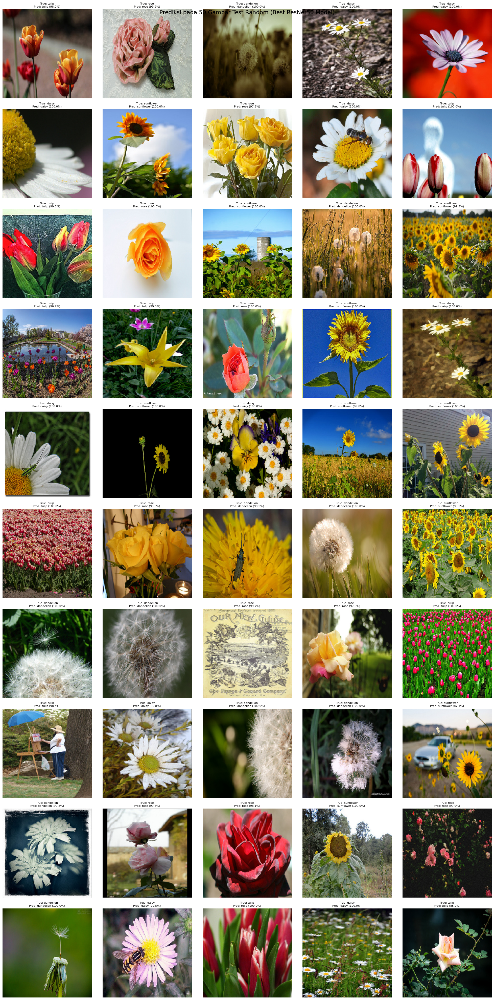

Akurasi prediksi pada 50 sample: 50/50 (100.0%)


In [ ]:
# Visualisasi dan prediksi pada 50 sample menggunakan best model
pred_results = []
fig, axes = plt.subplots(10, 5, figsize=(20, 40))  # 10 rows x 5 cols for 50 images
axes = axes.ravel()

for i, (file_path, true_cls) in enumerate(selected_test_files):
    img = load_img(file_path, target_size=IMG_SIZE)
    img_array = img_to_array(img)
    img_array = preprocess_input(img_array)
    img_array = np.expand_dims(img_array, axis=0)

    pred = best_model.predict(img_array, verbose=0)
    pred_cls = classes[np.argmax(pred)]
    confidence = np.max(pred) * 100

    pred_results.append((true_cls, pred_cls))

    orig_img = load_img(file_path, target_size=IMG_SIZE)
    axes[i].imshow(orig_img)
    axes[i].set_title(f'True: {true_cls}\nPred: {pred_cls} ({confidence:.1f}%)', fontsize=8)
    axes[i].axis('off')

plt.suptitle('Prediksi pada 50 Gambar Test Random (Best ResNet50 Model)', fontsize=16)
plt.tight_layout()
plt.show()

correct = sum(1 for true_cls, pred_cls in pred_results if true_cls == pred_cls)
print(f"Akurasi prediksi pada 50 sample: {correct}/50 ({correct/50*100:.1f}%)")